# Correlation Analysis

## Import packages

In [1]:
!pip install pandas openpyxl

In [2]:
!pip install numpy

In [3]:
!pip install seaborn

In [4]:
!pip install matplotlib

In [5]:
!pip install plotly

In [6]:
!pip install statsmodels

In [7]:
!pip install scikit_posthocs

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import scipy.stats as stats
import scikit_posthocs as sp
from scipy.cluster.hierarchy import linkage, leaves_list

## Numerical variables

In [78]:
# Import data
damage_all = pd.read_csv("../data/damage_all.csv")
damage_all.info()

C:\Users\franc\AppData\Local\Temp\ipykernel_13444\667513791.py:2: DtypeWarning:

Columns (12) have mixed types. Specify dtype option on import or set low_memory=False.



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 251865 entries, 0 to 251864
Data columns (total 45 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   EXPENSE                   251865 non-null  float64
 1   DAMAGE_CLUSTER_ID         251865 non-null  object 
 2   DATE_INITIAL_RESERVATION  251865 non-null  object 
 3   DATE_DAMAGE_EVENT         251865 non-null  object 
 4   CONTRACT_ID               251865 non-null  int64  
 5   INITIAL_RESERVATION       251865 non-null  float64
 6   TOTAL_DAMAGE              199375 non-null  float64
 7   BUSINESS_FIELD_ID         251865 non-null  int64  
 8   RESIDUAL_AMOUNT           251865 non-null  float64
 9   DAMAGE_TYPE               251865 non-null  object 
 10  DAMAGE_INCIDENT           251865 non-null  object 
 11  DAMAGE_EVENT_TOWN         251865 non-null  object 
 12  DAMAGE_EVENT_ZIP_CODE     251861 non-null  object 
 13  DAMAGE_EVENT_STREET       251864 non-null  o

In [10]:
len(damage_all)

251865

In [79]:
# Exclude rows where EXPENSE, PAYOUT, and RESIDUAL_AMOUNT are all zero
damage_all = damage_all[(damage_all['EXPENSE'] != 0) | (damage_all['PAYOUT'] != 0) | (damage_all['RESIDUAL_AMOUNT'] != 0)]
print(len(damage_all))

# Exclude rows where PIPE_PREMIUM_AMOUNT is na
damage_all = damage_all.dropna(subset=['PIPE_PREMIUM_AMOUNT'])
print(len(damage_all))

190724
168291


In [80]:
# Select the numerical variables for the correlation matrix
numericDf = damage_all[['EXPENSE', 'INITIAL_RESERVATION', 'TOTAL_DAMAGE', 'RESIDUAL_AMOUNT', 'PAYOUT', 'SUM_INSURED',
                            'LIVING_SPACE', 'PRIOR_DAMAGES', 'PIPE_PREMIUM_AMOUNT', 'RISK_SCORE']]
numericDf.head()

,EXPENSE,INITIAL_RESERVATION,TOTAL_DAMAGE,RESIDUAL_AMOUNT,PAYOUT,SUM_INSURED,LIVING_SPACE,PRIOR_DAMAGES,PIPE_PREMIUM_AMOUNT,RISK_SCORE
36,95.52,100.0,250.0,0.0,95.52,351680.0,140.00000,0.0,19.66104,4.858339
37,119.00,800.0,1000.0,0.0,119.00,1483210.0,106.24368,0.0,208.90002,0.569650
39,151.58,1500.0,1500.0,0.0,151.58,1270368.0,350.00000,0.0,272.19774,0.556875
40,204.07,500.0,300.0,0.0,204.07,446186.0,106.24368,0.0,83.26176,2.450945
42,212.27,900.0,1500.0,0.0,212.27,794800.0,106.24368,0.0,114.06438,1.860967


In [93]:
# Exclude outliers
numericDf = numericDf[(numericDf['EXPENSE'] <= 100000) & (numericDf['RISK_SCORE'] > 0.001)]

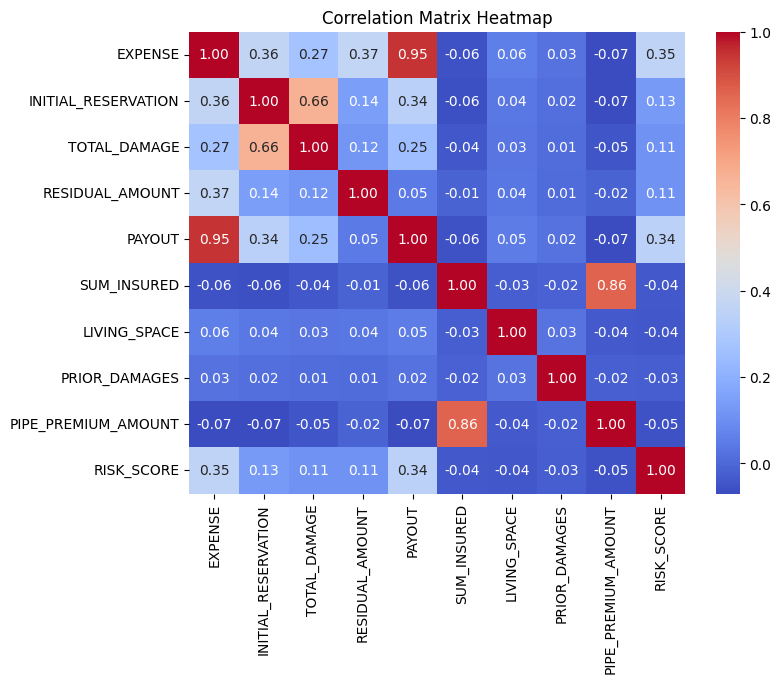

In [94]:
# Calculate the correlation matrix
corr_matrix = numericDf.corr()

# Visualize the correlation matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Matrix Heatmap')
plt.show()

Living space, sum insured and  prior damages are all uncorrelated with the risk score.

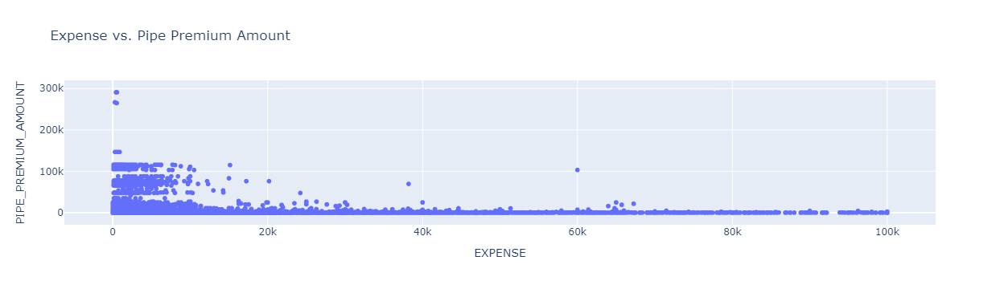

In [95]:
# Create a scatter plot
fig = px.scatter(numericDf, x='EXPENSE', y='PIPE_PREMIUM_AMOUNT', title='Expense vs. Pipe Premium Amount')

# Show the plot
fig.show()

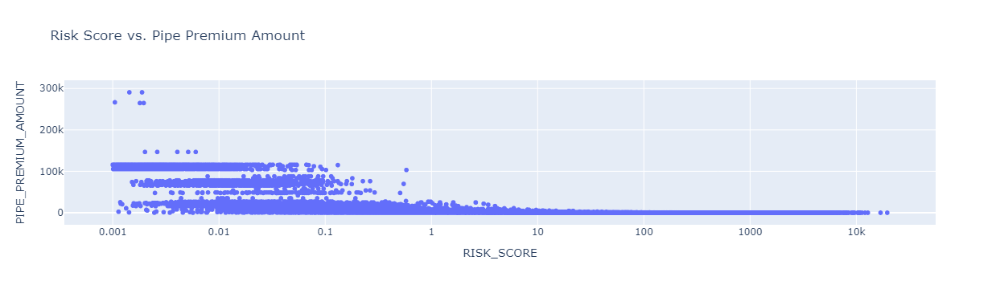

In [96]:
# Create a scatter plot
fig = px.scatter(numericDf, x='RISK_SCORE', y='PIPE_PREMIUM_AMOUNT', title='Risk Score vs. Pipe Premium Amount')

# Adding logarithmic scale
fig.update_layout(xaxis_type='log')

# Show the plot
fig.show()

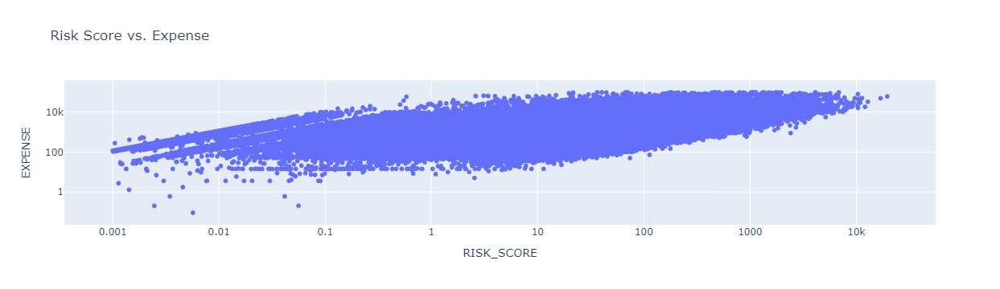

In [97]:
# Create a scatter plot
fig = px.scatter(numericDf, x='RISK_SCORE', y='EXPENSE', title='Risk Score vs. Expense')

# Adding logarithmic scale
fig.update_layout(xaxis_type='log', yaxis_type='log')

# Show the plot
fig.show()

## Categorical variables

In [19]:
categoryDf = damage_all[['RISK_SCORE', 'CORPORATE_DEVISION', 'DAMAGE_TYPE', 'DAMAGE_INCIDENT', 'DAMAGE_TRAIT_DESIGNMENT',
                         'DAMAGE_CAUSE_DESIGNMENT', 'DIVISION_LEVEL_00', 'ZONE', 'DRAIN_PIPE_INSURED',
                         'PRODUCTLINE', 'UNDERINSURANCE_WAIVER', 'UNDERWRITER', 'BUSINESS_FIELD_ID', 'STATISTIC_NUMBER'
                        ]]
categoryDf.head()

,RISK_SCORE,CORPORATE_DEVISION,DAMAGE_TYPE,DAMAGE_INCIDENT,DAMAGE_TRAIT_DESIGNMENT,DAMAGE_CAUSE_DESIGNMENT,DIVISION_LEVEL_00,ZONE,DRAIN_PIPE_INSURED,PRODUCTLINE,UNDERINSURANCE_WAIVER,UNDERWRITER,BUSINESS_FIELD_ID,STATISTIC_NUMBER
36,4.858339,H&H,Other pipe breakage,Water damage,Warm domestic water inside of buildings,Pipe breakage due to wear,Multi-Risk,A,0.0,NaN,1.0,Y,0,9932
37,0.569650,VGV,Other pipe breakage,Water damage,Cold domestic water inside of buildings,"Solid connections, seals",Property,2,0.0,Top,1.0,Y,0,11347
39,0.556875,VGV,Other,Water damage,Heating water inside of buildings (without flo...,Backflow (due to blockages),Property,3.0,0.0,Plus,1.0,Y,0,11077
40,2.450945,VGV,Water dripping from the ceiling,Water damage,Wastewater inside of buildings,Pipe breakage due to wear,Property,2,0.0,Top,1.0,Y,0,11057
42,1.860967,VGV,Other pipe breakage,Water damage,Warm domestic water inside of buildings,Pipe breakage due to wear,Property,2.0,0.0,Kompakt,1.0,Y,0,11057


### Kruskal-Wallis Test

In [20]:
# Kruskal-Wallis Test for CORPORATE_DEVISION

# Get unique categories
categories = categoryDf['CORPORATE_DEVISION'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['CORPORATE_DEVISION'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 46018.821873072666, P-value = 0.0


In [21]:
# Kruskal-Wallis Test for DAMAGE_TYPE

# Get unique categories
categories = categoryDf['DAMAGE_TYPE'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['DAMAGE_TYPE'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 7055.547952894443, P-value = 0.0


In [22]:
# Kruskal-Wallis Test for DAMAGE_INCIDENT

# Get unique categories
categories = categoryDf['DAMAGE_INCIDENT'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['DAMAGE_INCIDENT'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 34.75645366495414, P-value = 0.006695615301464863


In [23]:
categoryDf['DAMAGE_INCIDENT'].unique()

array(['Water damage', 'Other property damage', 'Elementary', 'explosion',
       'Branch not insured', 'Other H-damage', 'Damage to inventory',
       'Hail damage', 'Household/television appliances',
       'Damage to buildings/building components', 'Storm damage',
       'Fire damage', 'Rental property damage', 'Simple theft',
       'Other protection letter damage', 'Glass damage',
       'lightning strike', 'Burglary'], dtype=object)

In [24]:
# Kruskal-Wallis Test for DAMAGE_TRAIT_DESIGNMENT

# Get unique categories
categories = categoryDf['DAMAGE_TRAIT_DESIGNMENT'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['DAMAGE_TRAIT_DESIGNMENT'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 1737.3220850705377, P-value = 0.0


In [25]:
# Kruskal-Wallis Test for DAMAGE_CAUSE_DESIGNMENT

# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['DAMAGE_CAUSE_DESIGNMENT'])

# Get unique categories
categories = categoryDfDrop['DAMAGE_CAUSE_DESIGNMENT'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDfDrop[categoryDfDrop['DAMAGE_CAUSE_DESIGNMENT'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 6081.56629795004, P-value = 0.0


In [26]:
# Kruskal-Wallis Test for ZONE (more complex due to a bug)

# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['ZONE', 'RISK_SCORE'])

# Get unique categories from the cleaned DataFrame
categories = categoryDfDrop['ZONE'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDfDrop[categoryDfDrop['ZONE'] == category]['RISK_SCORE'] for category in categories]

# Check if any groups are empty
for data in groupedData:
    if data.empty:
        print("Warning: One or more groups are empty after filtering.")

# Perform Kruskal-Wallis Test, only if no groups are empty
if all(not data.empty for data in groupedData):
    kw = stats.kruskal(*groupedData)
    print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")
else:
    print("Kruskal-Wallis Test could not be performed due to empty groups.")

Kruskal-Wallis Test: H-statistic = 19467.945401174464, P-value = 0.0


In [31]:
# Kruskal-Wallis Test for PRODUCTLINE

# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['PRODUCTLINE', 'RISK_SCORE'])

# Get unique categories from the cleaned DataFrame
categories = categoryDfDrop['PRODUCTLINE'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDfDrop[categoryDfDrop['PRODUCTLINE'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 14016.488984670608, P-value = 0.0


In [32]:
# Kruskal-Wallis Test for UNDERINSURANCE_WAIVER

# Get unique categories
categories = categoryDf['UNDERINSURANCE_WAIVER'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['UNDERINSURANCE_WAIVER'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 8591.869173001996, P-value = 0.0


In [33]:
# Kruskal-Wallis Test for STATISTIC_NUMBER

# Get unique categories
categories = categoryDf['STATISTIC_NUMBER'].unique()

# Prepare data for Kruskal-Wallis Test
groupedData = [categoryDf[categoryDf['STATISTIC_NUMBER'] == category]['RISK_SCORE'] for category in categories]

# Perform Kruskal-Wallis Test
kw = stats.kruskal(*groupedData)
print(f"Kruskal-Wallis Test: H-statistic = {kw.statistic}, P-value = {kw.pvalue}")

Kruskal-Wallis Test: H-statistic = 49021.47374626667, P-value = 0.0


The test for DAMAGE_INCIDENT is not significant. All other tests are significant.

### Dunn's test

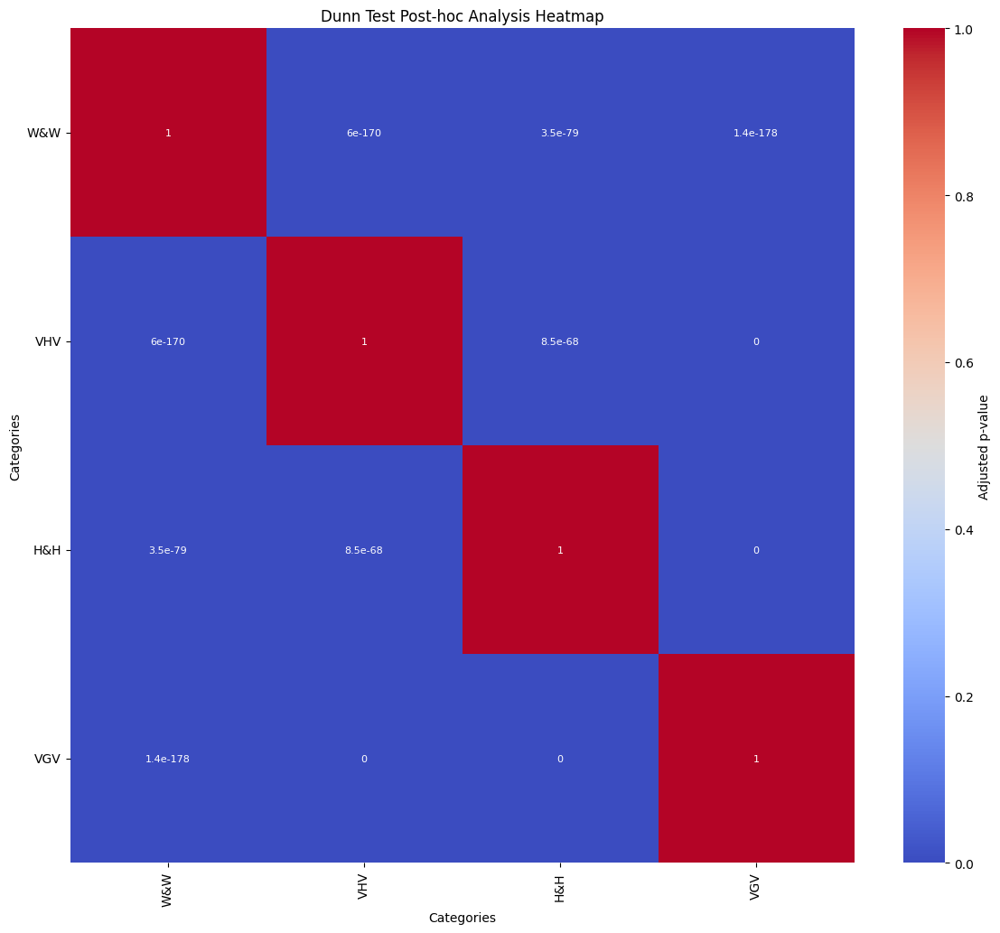

In [36]:
# Run Dunn's test
dunn = sp.posthoc_dunn(categoryDf, val_col='RISK_SCORE', group_col='CORPORATE_DEVISION', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=True, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

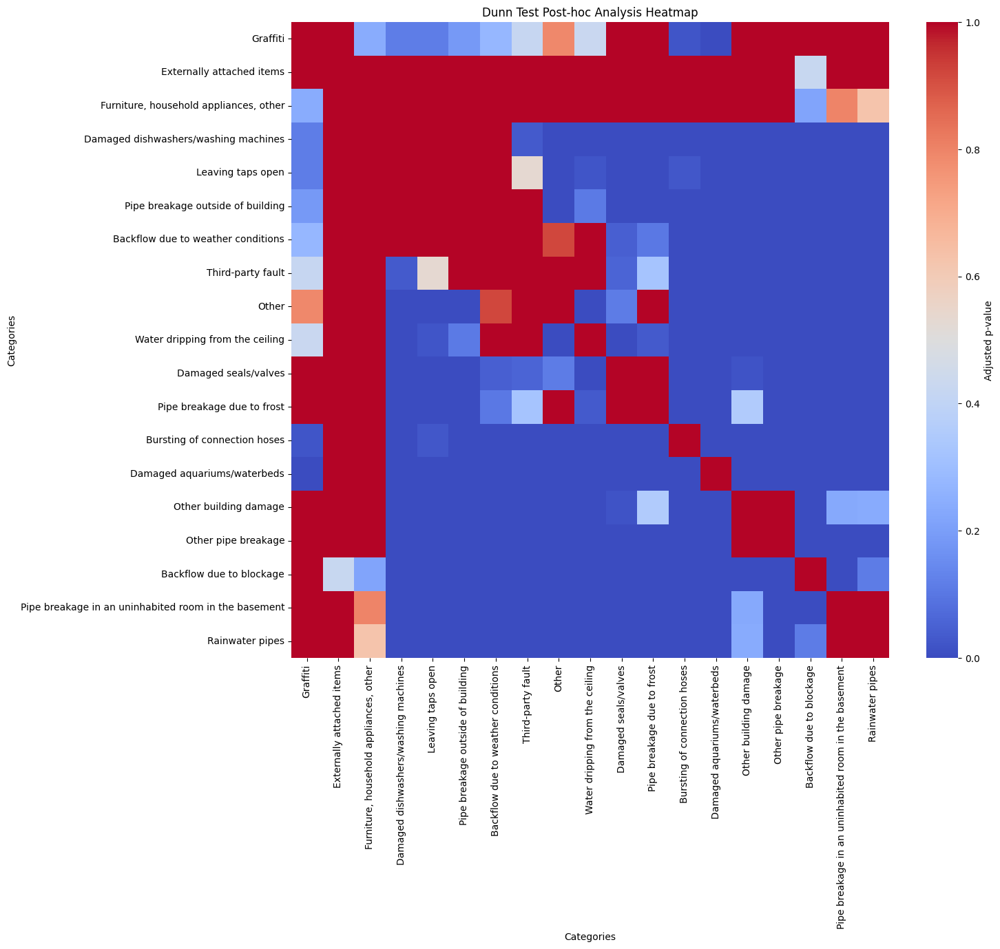

In [76]:
# Exclude categories where p-value = 1.0
excludeCategories = [
    'Basement',
    'Branch not insured',
    'Flood',
    'Pipe breakage in exposed pipes without consequential damage',
    'Pipe breakage in gas pipelines',
    'Pipe breakage in uninhabited outbuildings',
    'Poor implementation by installer',
    'Roof and other building components',
    'Roof without other building components',
    'Oil pollution',
    'Other externally attached items',
    'Other water damage',
    'Windows, doors, awnings, other',
    'Surge damage',
    'Unnamed hazards',
    'Other property damage',
    'Snow pressure',
    'Other building components',
    'Single floors',
    'Water damage with oil damage',
    'Entire building',
    'Ground subsidence',
    'Direct lightning strike',
    'Damaged canopies',
    'Break-in',
    'Damage to rented property',
    'Pipe breakage in a room with carpeting (sqm < 20 EUR)'
]

# Filter the DataFrame to exclude the specified categories
filter = categoryDf[~categoryDf['DAMAGE_TYPE'].isin(excludeCategories)]

# Run Dunn's test
dunn = sp.posthoc_dunn(filter, val_col='RISK_SCORE', group_col='DAMAGE_TYPE', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=False, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

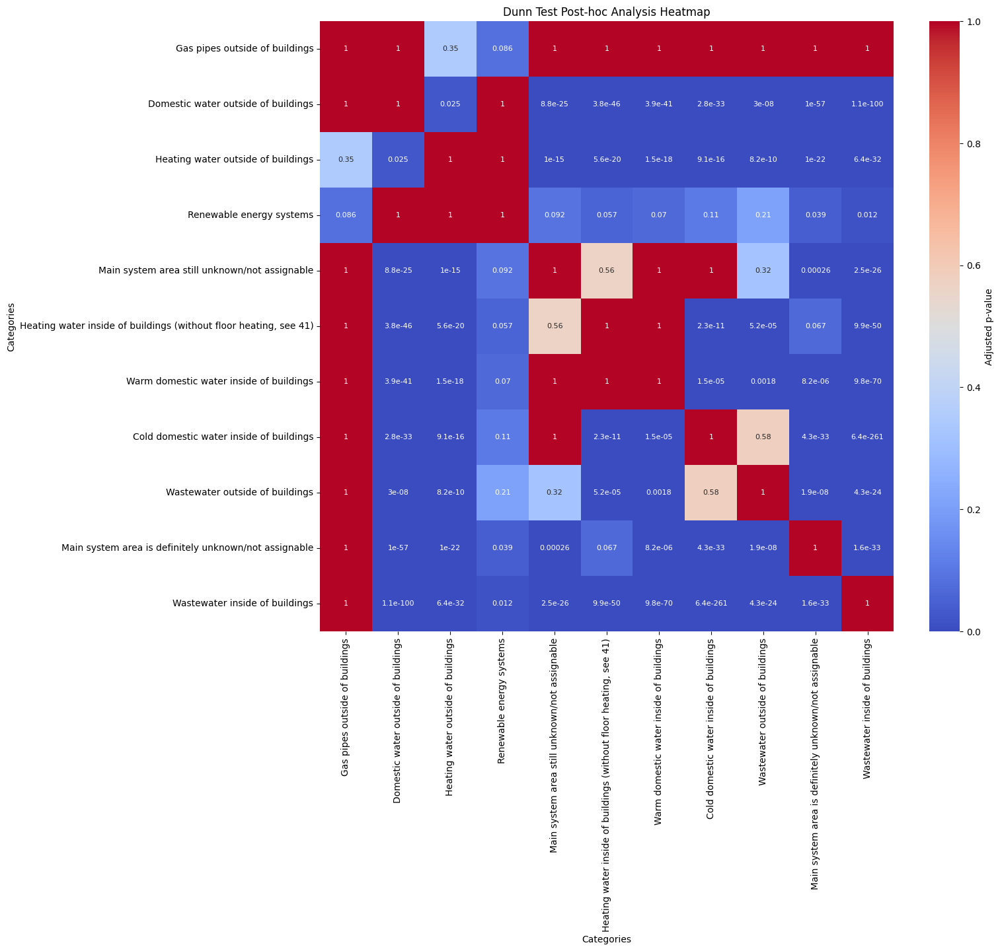

In [57]:
# Exclude categories where p-value = 1.0
excludeCategories = [
    'Domestic water outside of buildings and insurance property',
    'Gas pipes inside of buildings',
    'Heating water inside of buildings (only floor heating, otherwise 40)',
    'Heating water outside of buildings and insurance property',
    'Renewable energy system',
    'Wastewater outside of buildings and insurance property',
    'Renewable energy system and building components',
    'Renewable energy systems and building components'
]

# Filter the DataFrame to exclude the specified categories
filter = categoryDf[~categoryDf['DAMAGE_TRAIT_DESIGNMENT'].isin(excludeCategories)]

# Run Dunn's test
dunn = sp.posthoc_dunn(filter, val_col='RISK_SCORE', group_col='DAMAGE_TRAIT_DESIGNMENT', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=True, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

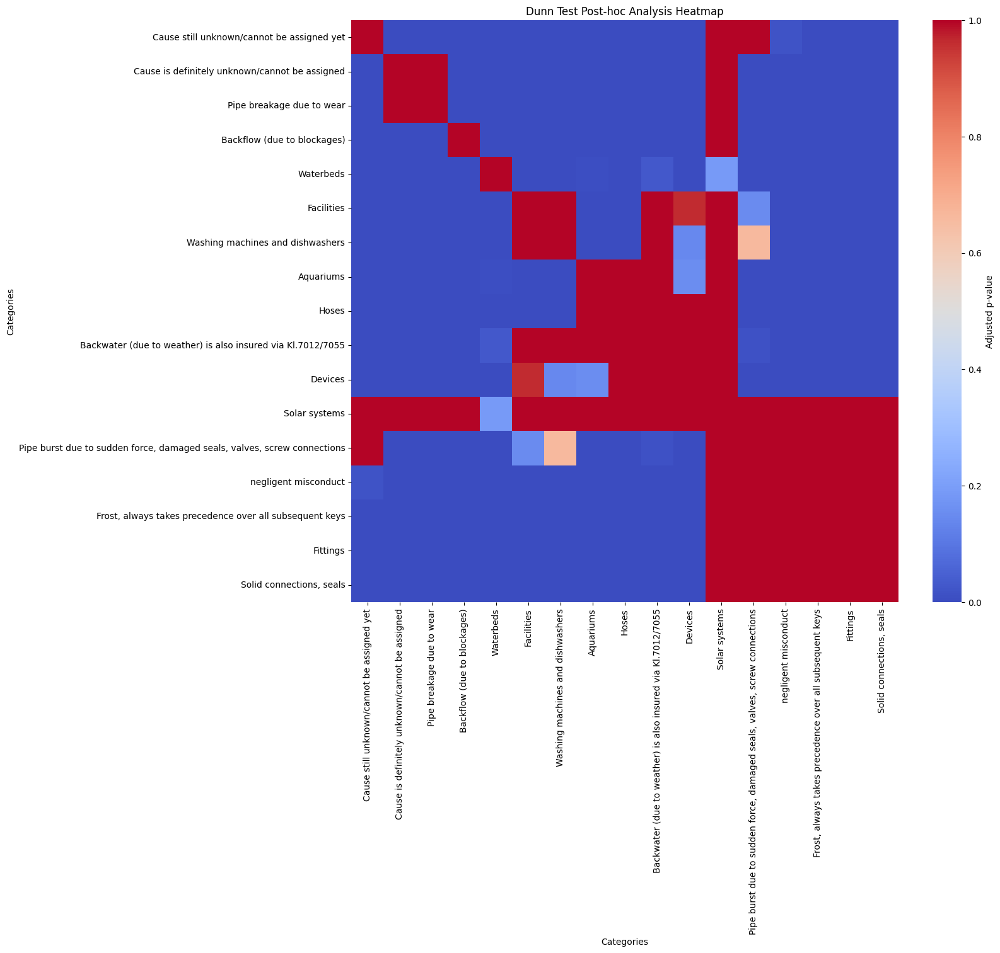

In [62]:
# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['DAMAGE_CAUSE_DESIGNMENT'])

# Exclude categories where p-value = 1.0
excludeCategories = [
    'Indoor fountains, water columns',
    'Falsely assigned, Cause of damage in another damage branch',
    'House and apartment protection letter'
]

# Filter the DataFrame to exclude the specified categories
filter = categoryDfDrop[~categoryDfDrop['DAMAGE_CAUSE_DESIGNMENT'].isin(excludeCategories)]

# Run Dunn's test
dunn = sp.posthoc_dunn(filter, val_col='RISK_SCORE', group_col='DAMAGE_CAUSE_DESIGNMENT', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=False, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

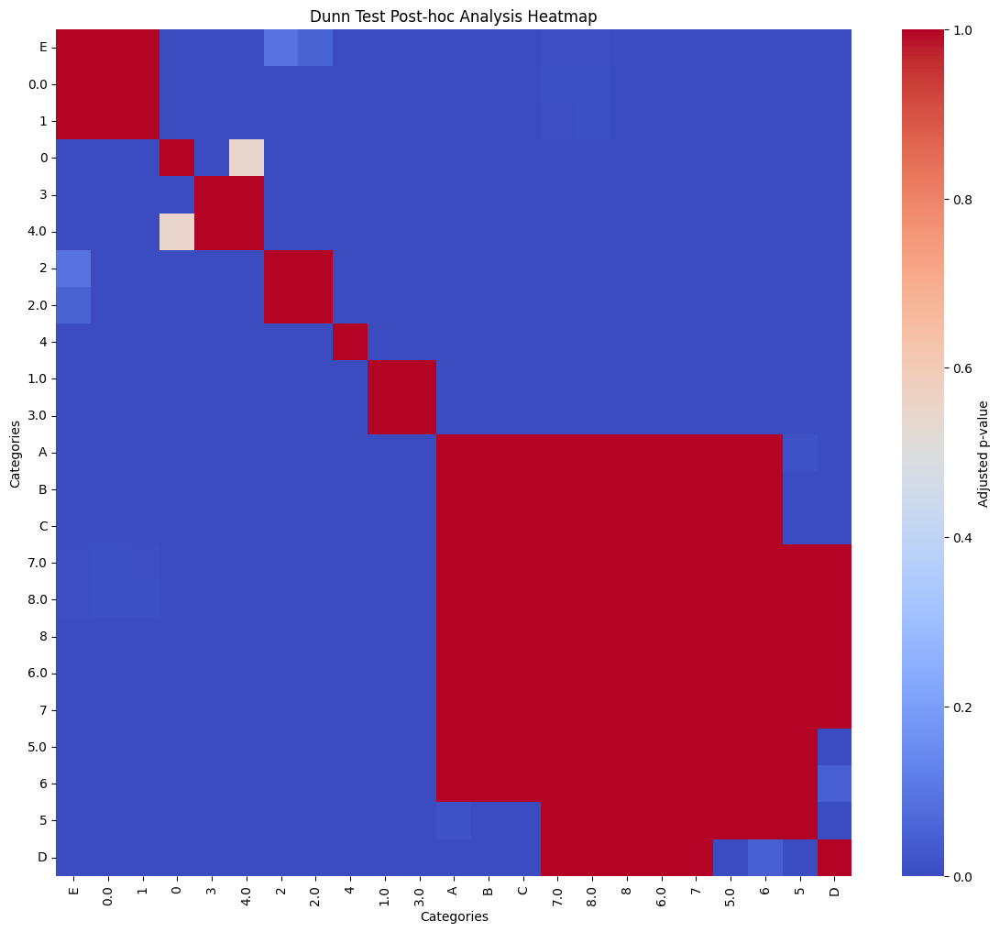

In [63]:
# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['ZONE'])

# Run Dunn's test
dunn = sp.posthoc_dunn(categoryDfDrop, val_col='RISK_SCORE', group_col='ZONE', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=False, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

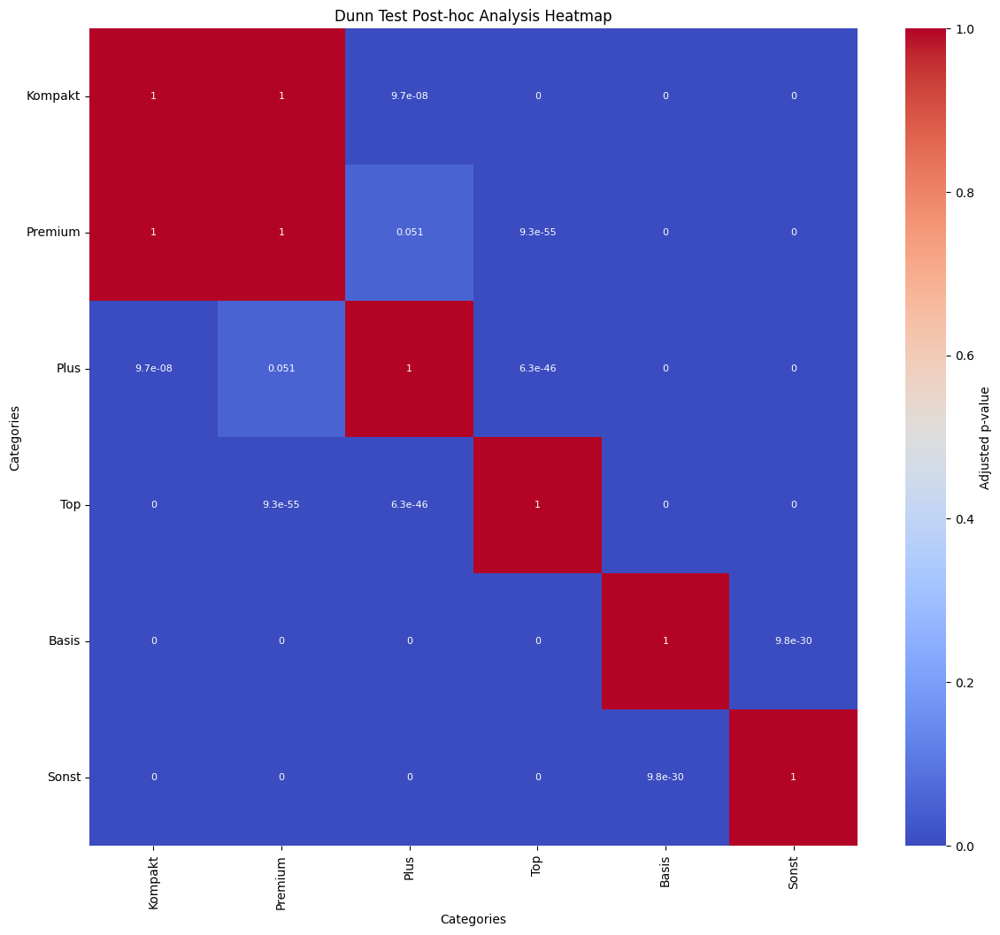

In [43]:
# Drop nas
categoryDfDrop = categoryDf.dropna(subset=['PRODUCTLINE', 'RISK_SCORE'])

# Run Dunn's test
dunn = sp.posthoc_dunn(categoryDfDrop, val_col='RISK_SCORE', group_col='PRODUCTLINE', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=True, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

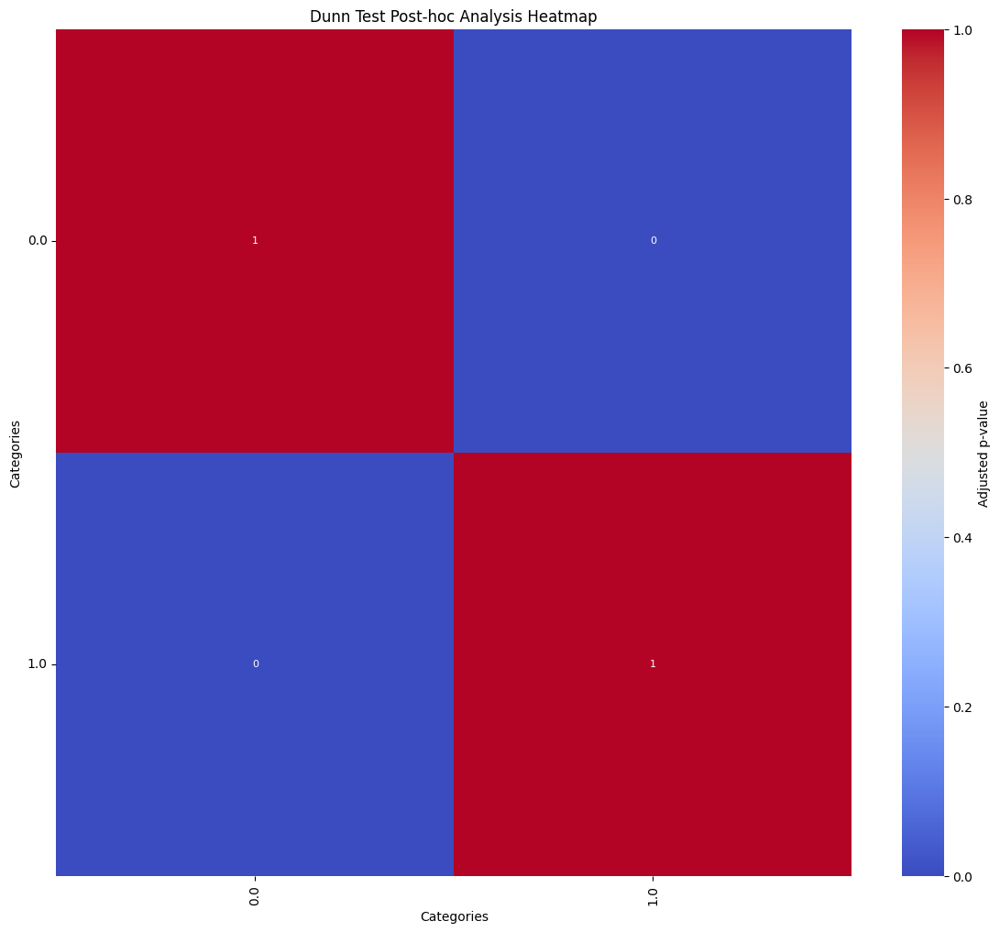

In [44]:
# Run Dunn's test
dunn = sp.posthoc_dunn(categoryDf, val_col='RISK_SCORE', group_col='UNDERINSURANCE_WAIVER', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=True, fmt='.2g', cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

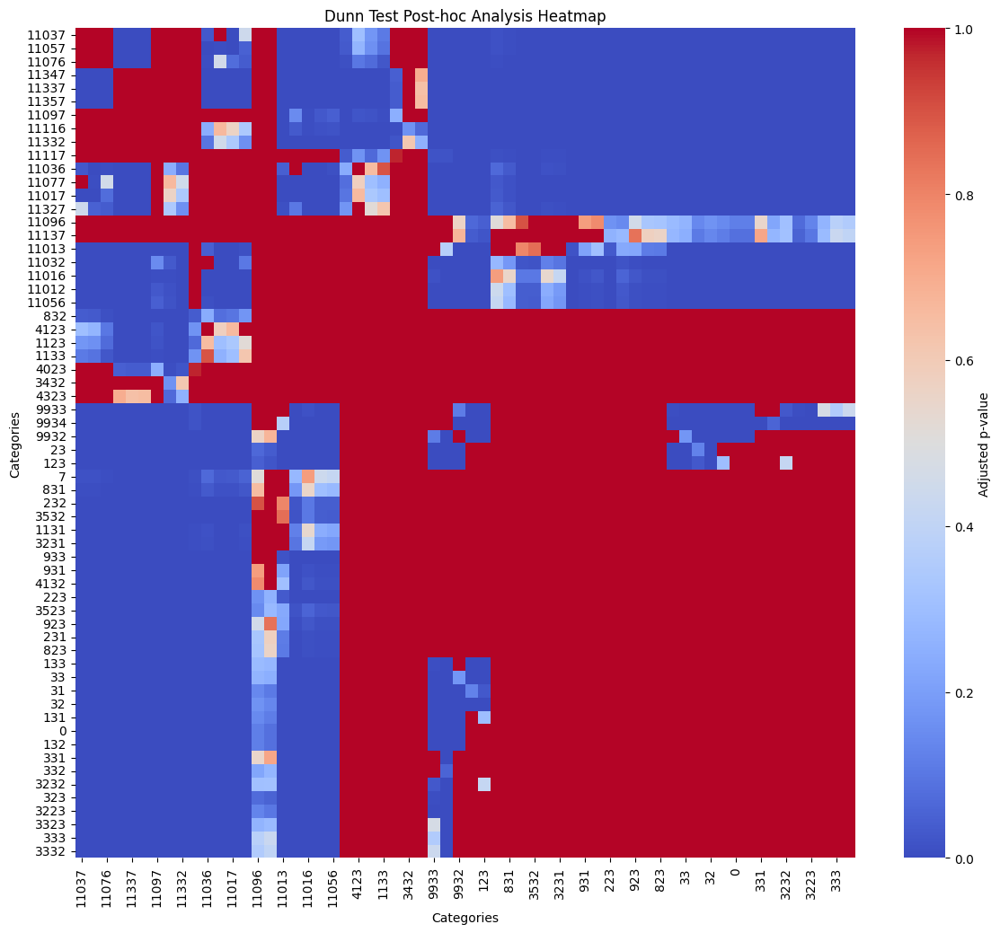

In [75]:
# Exclude categories where p-value = 1.0
excludeCategories = [
    15, 107, 11323, 11326, 11336, 11346, 11356, 11297, 11322, 233, 423, 431, 433, 733, 833, 932, 1132, 1323, 11033,
    11053, 1331, 1333, 1523, 1623, 6132, 2533, 2733, 3123, 3233, 3331, 5923, 3423, 3533, 5723, 3932, 4032, 4332, 34,
    11317, 4232, 3623, 2133, 1033, 2523, 432, 3732, 1731, 11157, 11092, 533
]

# Filter the DataFrame to exclude the specified categories
filter = categoryDf[~categoryDf['STATISTIC_NUMBER'].isin(excludeCategories)]

# Run Dunn's test
dunn = sp.posthoc_dunn(filter, val_col='RISK_SCORE', group_col='STATISTIC_NUMBER', p_adjust='bonferroni')

# Convert Dunn test result to a DataFrame for visualization
dunn_df = pd.DataFrame(dunn)

# Perform hierarchical clustering to reorder the categories
linkage_matrix = linkage(dunn_df, method='complete')
ordered_indices = leaves_list(linkage_matrix)
ordered_df = dunn_df.iloc[ordered_indices, ordered_indices]

# Plot the heatmap with adjusted font size and ordered categories
plt.figure(figsize=(14, 12))
sns.heatmap(ordered_df, annot=False, cmap="coolwarm", cbar_kws={'label': 'Adjusted p-value'}, annot_kws={"size": 8})
plt.title('Dunn Test Post-hoc Analysis Heatmap')
plt.xlabel('Categories')
plt.ylabel('Categories')
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.show()

Variables with high impact on risk score: CORPORATE_DEVISION, UNDERINSURANCE_WAIVER, PRODUCTLINE, ZONE, DAMAGE_TRAIT_DESIGNMENT, DAMAGE_CAUSE_DESIGNMENT, DAMAGE_TYPE

Variables with low impact on risk score: STATISTIC_NUMBER, DAMAGE_INCIDENT